In [1]:
'''
!pip install "dask[dataframe]"
!pip install numpy==1.24.4
! pip install -U bottleneck
!pip install -U seaborn
!pip install optuna
!pip uninstall -y shap numba
!pip install shap==0.43.0 numba==0.59.1
'''

'\n!pip install "dask[dataframe]"\n!pip install numpy==1.24.4\n! pip install -U bottleneck\n!pip install -U seaborn\n!pip install optuna\n!pip uninstall -y shap numba\n!pip install shap==0.43.0 numba==0.59.1\n'

In [2]:
# import sys
# !"{sys.executable}" -m pip install optuna

In [3]:
import random
import numpy as np
import os

seed = 42
random.seed(seed)
np.random.seed(seed)
os.environ['PYTHONHASHSEED'] = str(seed)

In [4]:
import matplotlib.pyplot as plt
import matplotlib as mpl
import pandas as pd
import seaborn as sns
import numpy as np
import plotly.express as px

mpl.rcParams['font.family'] = 'Malgun Gothic' 
mpl.rcParams['axes.unicode_minus'] = False  

pd.set_option('display.max_columns', None)    
pd.set_option('display.max_rows', None)       
pd.set_option('display.width', None)   

In [5]:
df = pd.read_csv("df_final.csv") # 결측치 보간 & 원핫인코딩까지 된 버전
df

,연도,시군구명,법정동명,법정동,법정동코드,0_3m_최다지층_경암층,0_3m_최다지층_기타,0_3m_최다지층_매립토층,0_3m_최다지층_붕적토층,0_3m_최다지층_전답토층,0_3m_최다지층_퇴적토층,0_3m_최다지층_풍화암층,0_3m_최다지층_풍화토층,3_10m_최다지층_기타,3_10m_최다지층_매립토층,3_10m_최다지층_붕적토층,3_10m_최다지층_연암층,3_10m_최다지층_퇴적토층,3_10m_최다지층_풍화암층,3_10m_최다지층_풍화토층,10_20m_최다지층_경암층,10_20m_최다지층_연암층,10_20m_최다지층_퇴적토층,10_20m_최다지층_풍화암층,10_20m_최다지층_풍화토층,20_30m_최다지층_경암층,20_30m_최다지층_연암층,20_30m_최다지층_풍화암층,20_30m_최다지층_풍화토층,30m이하_최다지층_경암층,30m이하_최다지층_연암층,30m이하_최다지층_풍화암층,30m이하_최다지층_풍화토층,전체_우세지층_경암층,전체_우세지층_기타,전체_우세지층_매립토층,전체_우세지층_붕적토층,전체_우세지층_연암층,전체_우세지층_전답토층,전체_우세지층_퇴적토층,전체_우세지층_풍화암층,전체_우세지층_풍화토층,평균 침수심,평균 침수면적,평균 침수위,평균 침수시간,침수여부,공사횟수,평균굴착용적,평균굴착면적,평균최대굴착깊이,시설용량,처리구역면적_합류식,처리구역면적_분류식,하수관로_총시설연장,하수관로_지선합류식,하수관로_지선분류식,용량_대_면적,지선_합류_대_분류,지하철역_개수,싱크홀 발생 여부
0,2018,강남구,개포동,강남구_개포동,1168010300,True,False,False,False,False,False,False,False,False,False,False,False,False,True,False,False,True,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,True,False,0.50,108.00,18.94,150.00,1,0,NaN,NaN,NaN,2530000.0,20.500,10.0,723869.391,569369.960,119717.011,82950.819672,0.826267,0,0
1,2019,강남구,개포동,강남구_개포동,1168010300,True,False,False,False,False,False,False,False,False,False,False,False,False,True,False,False,True,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,True,False,NaN,NaN,NaN,NaN,0,0,NaN,NaN,NaN,2530000.0,20.500,10.0,723869.391,569369.960,119717.011,82950.819672,0.826267,0,0
2,2020,강남구,개포동,강남구_개포동,1168010300,True,False,False,False,False,False,False,False,False,False,False,False,False,True,False,False,True,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,True,False,NaN,NaN,NaN,NaN,0,0,NaN,NaN,NaN,2530000.0,20.500,10.0,723869.391,569369.960,119717.011,82950.819672,0.826267,0,0
3,2021,강남구,개포동,강남구_개포동,1168010300,True,False,False,False,False,False,False,False,False,False,False,False,False,True,False,False,True,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,True,False,NaN,NaN,NaN,NaN,0,1,0.000000,0.0,24.810000,2530000.0,20.500,10.0,723869.391,569369.960,119717.011,82950.819672,0.826267,0,0
4,2022,강남구,개포동,강남구_개포동,1168010300,True,False,False,False,False,False,False,False,False,False,False,False,False,True,False,False,True,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,True,False,0.30,687.30,25.72,50.35,1,2,0.000000,0.0,20.335000,2530000.0,20.500,10.0,731957.510,552981.170,144193.980,82950.819672,0.793174,0,1
5,2023,강남구,개포동,강남구_개포동,1168010300,True,False,False,False,False,False,False,False,False,False,False,False,False,True,False,False,True,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,True,False,NaN,NaN,NaN,NaN,0,4,0.000000,0.0,23.600000,2530000.0,20.500,10.0,732317.970,552556.780,144975.580,82950.819672,0.792159,0,0
6,2024,강남구,개포동,강남구_개포동,1168010300,True,False,False,False,False,False,False,False,False,False,False,False,False,True,False,False,True,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,True,False,NaN,NaN,NaN,NaN,0,3,0.000000,0.0,23.196667,2530000.0,20.500,10.0,732317.970,552556.780,144975.580,82950.819672,0.792159,0,0
7,2025,강남구,개포동,강남구_개포동,1168010300,True,False,False,False,False,False,False,False,False,False,False,False,False,True,False,False,True,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,True,False,NaN,NaN,NaN,NaN,0,4,100.000000,0.0,20.517500,2530000.0,20.500,10.0,732317.970,552556.780,144975.580,82950.819672,0.792159,0,0
8,2018,강남구,논현동,강남구_논현동,1168010800,True,False,False,False,False,False,False,False,False,False,False,False,False,True,False,False,True,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,True,False,0.43,213.90,23.44,15

In [6]:
df.columns

Index(['연도', '시군구명', '법정동명', '법정동', '법정동코드', '0_3m_최다지층_경암층', '0_3m_최다지층_기타',
       '0_3m_최다지층_매립토층', '0_3m_최다지층_붕적토층', '0_3m_최다지층_전답토층', '0_3m_최다지층_퇴적토층',
       '0_3m_최다지층_풍화암층', '0_3m_최다지층_풍화토층', '3_10m_최다지층_기타', '3_10m_최다지층_매립토층',
       '3_10m_최다지층_붕적토층', '3_10m_최다지층_연암층', '3_10m_최다지층_퇴적토층',
       '3_10m_최다지층_풍화암층', '3_10m_최다지층_풍화토층', '10_20m_최다지층_경암층',
       '10_20m_최다지층_연암층', '10_20m_최다지층_퇴적토층', '10_20m_최다지층_풍화암층',
       '10_20m_최다지층_풍화토층', '20_30m_최다지층_경암층', '20_30m_최다지층_연암층',
       '20_30m_최다지층_풍화암층', '20_30m_최다지층_풍화토층', '30m이하_최다지층_경암층',
       '30m이하_최다지층_연암층', '30m이하_최다지층_풍화암층', '30m이하_최다지층_풍화토층', '전체_우세지층_경암층',
       '전체_우세지층_기타', '전체_우세지층_매립토층', '전체_우세지층_붕적토층', '전체_우세지층_연암층',
       '전체_우세지층_전답토층', '전체_우세지층_퇴적토층', '전체_우세지층_풍화암층', '전체_우세지층_풍화토층',
       '평균 침수심', '평균 침수면적', '평균 침수위', '평균 침수시간', '침수여부', '공사횟수', '평균굴착용적',
       '평균굴착면적', '평균최대굴착깊이', '시설용량', '처리구역면적_합류식', '처리구역면적_분류식', '하수관로_총시설연장',
       '하수관로_지선합류식', '하수관로_지선분류식', '용량_대_면적', '지선_합류_대_분류', '지하철역_개수',

In [7]:
loc_col = ["연도", "시군구명", "법정동명", "법정동", "법정동코드"]
ground_col = [
    "시추공수", "총측정심도", "평균지하수위", '0_3m_최다지층_가중치', '3_10m_최다지층_가중치',
    '10_20m_최다지층_가중치', '20_30m_최다지층_가중치', '30m이하_최다지층_가중치', '전체_우세지층_가중치',
    "풍화암층_출현심도", "연암층_출현심도", "경암층_출현심도", "지층_다양성", "상위3개지층_비율"
]
flood_col = ["평균 침수심", "평균 침수면적", "평균 침수위", "평균 침수시간"]
construction_col = ["공사횟수", "평균굴착용적", "평균굴착면적", "평균최대굴착깊이"]
drain_col = [
    "시설용량", "처리구역면적_합류식", "처리구역면적_분류식",
    "하수관로_총시설연장", "하수관로_지선합류식", "하수관로_지선분류식"
]
target_col = ["싱크홀 발생 여부"]

In [8]:
# his_col = ["싱크홀 발생 누적 횟수"]

## 학습/테스트 분리

In [9]:
# 연도 기준으로 학습/테스트 분리
df_train = df[df["연도"] < 2025].copy() # 2018-2024년을 훈련셋으로!
df_test = df[df["연도"] == 2025].copy() # 2025년을 테스트셋으로!

df_train.shape, df_test.shape

((3269, 61), (467, 61))

In [10]:
df_train.head()

,연도,시군구명,법정동명,법정동,법정동코드,0_3m_최다지층_경암층,0_3m_최다지층_기타,0_3m_최다지층_매립토층,0_3m_최다지층_붕적토층,0_3m_최다지층_전답토층,0_3m_최다지층_퇴적토층,0_3m_최다지층_풍화암층,0_3m_최다지층_풍화토층,3_10m_최다지층_기타,3_10m_최다지층_매립토층,3_10m_최다지층_붕적토층,3_10m_최다지층_연암층,3_10m_최다지층_퇴적토층,3_10m_최다지층_풍화암층,3_10m_최다지층_풍화토층,10_20m_최다지층_경암층,10_20m_최다지층_연암층,10_20m_최다지층_퇴적토층,10_20m_최다지층_풍화암층,10_20m_최다지층_풍화토층,20_30m_최다지층_경암층,20_30m_최다지층_연암층,20_30m_최다지층_풍화암층,20_30m_최다지층_풍화토층,30m이하_최다지층_경암층,30m이하_최다지층_연암층,30m이하_최다지층_풍화암층,30m이하_최다지층_풍화토층,전체_우세지층_경암층,전체_우세지층_기타,전체_우세지층_매립토층,전체_우세지층_붕적토층,전체_우세지층_연암층,전체_우세지층_전답토층,전체_우세지층_퇴적토층,전체_우세지층_풍화암층,전체_우세지층_풍화토층,평균 침수심,평균 침수면적,평균 침수위,평균 침수시간,침수여부,공사횟수,평균굴착용적,평균굴착면적,평균최대굴착깊이,시설용량,처리구역면적_합류식,처리구역면적_분류식,하수관로_총시설연장,하수관로_지선합류식,하수관로_지선분류식,용량_대_면적,지선_합류_대_분류,지하철역_개수,싱크홀 발생 여부
0,2018,강남구,개포동,강남구_개포동,1168010300,True,False,False,False,False,False,False,False,False,False,False,False,False,True,False,False,True,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,True,False,0.5,108.0,18.94,150.00,1,0,NaN,NaN,NaN,2530000.0,20.5,10.0,723869.391,569369.96,119717.011,82950.819672,0.826267,0,0
1,2019,강남구,개포동,강남구_개포동,1168010300,True,False,False,False,False,False,False,False,False,False,False,False,False,True,False,False,True,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,True,False,NaN,NaN,NaN,NaN,0,0,NaN,NaN,NaN,2530000.0,20.5,10.0,723869.391,569369.96,119717.011,82950.819672,0.826267,0,0
2,2020,강남구,개포동,강남구_개포동,1168010300,True,False,False,False,False,False,False,False,False,False,False,False,False,True,False,False,True,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,True,False,NaN,NaN,NaN,NaN,0,0,NaN,NaN,NaN,2530000.0,20.5,10.0,723869.391,569369.96,119717.011,82950.819672,0.826267,0,0
3,2021,강남구,개포동,강남구_개포동,1168010300,True,False,False,False,False,False,False,False,False,False,False,False,False,True,False,False,True,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,True,False,NaN,NaN,NaN,NaN,0,1,0.0,0.0,24.810,2530000.0,20.5,10.0,723869.391,569369.96,119717.011,82950.819672,0.826267,0,0
4,2022,강남구,개포동,강남구_개포동,1168010300,True,False,False,False,False,False,False,False,False,False,False,False,False,True,False,False,True,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,True,False,0.3,687.3,25.72,50.35,1,2,0.0,0.0,20.335,2530000.0,20.5,10.0,731957.510,552981.17,144193.980,82950.819672,0.793174,0,1


In [11]:
df_test[df_test["싱크홀 발생 여부"] == 1].head()

,연도,시군구명,법정동명,법정동,법정동코드,0_3m_최다지층_경암층,0_3m_최다지층_기타,0_3m_최다지층_매립토층,0_3m_최다지층_붕적토층,0_3m_최다지층_전답토층,0_3m_최다지층_퇴적토층,0_3m_최다지층_풍화암층,0_3m_최다지층_풍화토층,3_10m_최다지층_기타,3_10m_최다지층_매립토층,3_10m_최다지층_붕적토층,3_10m_최다지층_연암층,3_10m_최다지층_퇴적토층,3_10m_최다지층_풍화암층,3_10m_최다지층_풍화토층,10_20m_최다지층_경암층,10_20m_최다지층_연암층,10_20m_최다지층_퇴적토층,10_20m_최다지층_풍화암층,10_20m_최다지층_풍화토층,20_30m_최다지층_경암층,20_30m_최다지층_연암층,20_30m_최다지층_풍화암층,20_30m_최다지층_풍화토층,30m이하_최다지층_경암층,30m이하_최다지층_연암층,30m이하_최다지층_풍화암층,30m이하_최다지층_풍화토층,전체_우세지층_경암층,전체_우세지층_기타,전체_우세지층_매립토층,전체_우세지층_붕적토층,전체_우세지층_연암층,전체_우세지층_전답토층,전체_우세지층_퇴적토층,전체_우세지층_풍화암층,전체_우세지층_풍화토층,평균 침수심,평균 침수면적,평균 침수위,평균 침수시간,침수여부,공사횟수,평균굴착용적,평균굴착면적,평균최대굴착깊이,시설용량,처리구역면적_합류식,처리구역면적_분류식,하수관로_총시설연장,하수관로_지선합류식,하수관로_지선분류식,용량_대_면적,지선_합류_대_분류,지하철역_개수,싱크홀 발생 여부
23,2025,강남구,대치동,강남구_대치동,1168010600,True,False,False,False,False,False,False,False,False,False,False,False,False,True,False,False,True,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,True,False,NaN,NaN,NaN,NaN,0,7,0.0,0.0,19.512857,2530000.0,20.5,10.0,732317.97,552556.78,144975.58,82950.819672,0.792159,2,1
31,2025,강남구,도곡동,강남구_도곡동,1168011800,True,False,False,False,False,False,False,False,False,False,False,False,False,True,False,False,True,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,True,False,NaN,NaN,NaN,NaN,0,3,0.0,0.0,14.413333,2530000.0,20.5,10.0,732317.97,552556.78,144975.58,82950.819672,0.792159,2,1
79,2025,강남구,역삼동,강남구_역삼동,1168010100,True,False,False,False,False,False,False,False,False,False,False,False,False,True,False,False,True,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,True,False,NaN,NaN,NaN,NaN,0,24,0.0,0.0,25.740000,2530000.0,20.5,10.0,732317.97,552556.78,144975.58,82950.819672,0.792159,2,1
151,2025,강동구,명일동,강동구_명일동,1174010100,False,False,False,False,False,True,False,False,False,False,False,False,False,False,True,False,True,False,False,False,True,False,False,False,False,False,True,False,False,False,False,False,True,False,False,False,False,NaN,NaN,NaN,NaN,0,2,0.0,0.0,19.970000,900000.0,11.0,7.6,474454.63,356800.59,97797.85,48387.096774,0.784870,2,1
191,2025,강북구,미아동,강북구_미아동,1130510100,False,False,True,False,False,False,False,False,False,False,True,False,False,False,False,False,False,False,True,False,False,True,False,False,False,False,False,False,False,False,False,False,False,False,True,False,False,NaN,NaN,NaN,NaN,0,8,0.0,0.0,21.746250,1590000.0,9.0,2.3,356780.21,331223.80,3698.24,140707.964602,0.988958,2,1


In [12]:
# 타겟 및 피처 설정
target = "싱크홀 발생 여부"
exclude_cols = [col for col in loc_col + [target]]
features = [col for col in df_train.columns if col not in exclude_cols]

X = df_train[features].copy()
y = df_train[target].copy()

In [13]:
from lightgbm import LGBMClassifier
from sklearn.model_selection import StratifiedKFold
from sklearn.metrics import roc_auc_score, classification_report

## LightGBM

In [14]:
# 1. 결측치 처리
X_train = df_train[features].fillna(-999)
y_train = df_train[target]
X_test = df_test[features].fillna(-999)
y_test = df_test[target]

X = X_train
y = y_train

In [17]:
# =============================================================================
# 1: 커스텀 평가지표 정의
# =============================================================================
import numpy as np
from sklearn.metrics import precision_recall_curve, f1_score, fbeta_score, balanced_accuracy_score
import optuna
from lightgbm import LGBMClassifier
from sklearn.model_selection import StratifiedKFold
from sklearn.metrics import roc_auc_score, classification_report, recall_score

def custom_eval_metric(y_true, y_pred_proba, beta=2):
    """
    불균형 데이터셋을 위한 커스텀 평가지표
    F-beta score를 사용하여 Recall에 더 높은 가중치 부여
    """
    # 최적 threshold 찾기
    precision, recall, thresholds = precision_recall_curve(y_true, y_pred_proba)
    
    # F-beta score 계산 (beta > 1이면 recall에 더 높은 가중치)
    fbeta_scores = []
    for i in range(len(thresholds)):
        if precision[i] > 0 or recall[i] > 0:
            fbeta = (1 + beta**2) * (precision[i] * recall[i]) / (beta**2 * precision[i] + recall[i])
            fbeta_scores.append(fbeta)
        else:
            fbeta_scores.append(0)
    
    if fbeta_scores:
        return max(fbeta_scores)
    else:
        return 0

# =============================================================================
# 2: Optuna Objective 함수: 커스텀 평가지표 추가
# =============================================================================
def improved_objective(trial):
    params = {
        'n_estimators': trial.suggest_int('n_estimators', 100, 800),
        'learning_rate': trial.suggest_float('learning_rate', 0.01, 0.05, log=True),
        'num_leaves': trial.suggest_int('num_leaves', 16, 128),
        'max_depth': trial.suggest_categorical('max_depth', [3, 5, 7, 9, 11]),
        'min_child_samples': trial.suggest_int('min_child_samples', 10, 100),
        'subsample': trial.suggest_float('subsample', 0.6, 1.0),
        'colsample_bytree': trial.suggest_float('colsample_bytree', 0.6, 1.0),
        'reg_alpha': trial.suggest_float('reg_alpha', 0.0, 2.0),
        'reg_lambda': trial.suggest_float('reg_lambda', 0.0, 2.0),
        'scale_pos_weight': trial.suggest_int('scale_pos_weight', 3, 30),  # 범위 확장
        'random_state': 42,
        'verbose': -1,
        'class_weight': 'balanced',  # 추가
        'n_jobs': 1 
    }

    cv = StratifiedKFold(n_splits=5, shuffle=True, random_state=42)
    scores = []

    for train_idx, val_idx in cv.split(X, y):
        X_t, X_v = X.iloc[train_idx], X.iloc[val_idx]
        y_t, y_v = y.iloc[train_idx], y.iloc[val_idx]

        model = LGBMClassifier(**params)
        model.fit(X_t, y_t)
        
        # 확률 예측
        y_pred_proba = model.predict_proba(X_v)[:, 1]
        
        # 커스텀 평가지표 사용
        score = custom_eval_metric(y_v, y_pred_proba, beta=2)
        scores.append(score)

    return np.mean(scores)

# =============================================================================
# 3: 하이퍼파라미터 튜닝 실행
# =============================================================================
print("하이퍼파라미터 튜닝 시작...")
study = optuna.create_study(direction='maximize',sampler=optuna.samplers.TPESampler(seed=42))
study.optimize(improved_objective, n_trials=200)  

best_params = study.best_params
best_score = study.best_value
print("최적의 하이퍼파라미터:", best_params)
print(f"최적의 F-beta Score: {best_score:.4f}")

C:\Users\yrlee\anaconda3\envs\shap_env2\lib\site-packages\tqdm\auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm
[I 2025-06-29 12:46:05,085] A new study created in memory with name: no-name-98b3a87a-24fb-47cb-b7c7-2d6adc2af67d


하이퍼파라미터 튜닝 시작...


[I 2025-06-29 12:46:08,568] Trial 0 finished with value: 0.2087838363370278 and parameters: {'n_estimators': 362, 'learning_rate': 0.046187109390049115, 'num_leaves': 98, 'max_depth': 11, 'min_child_samples': 64, 'subsample': 0.8832290311184181, 'colsample_bytree': 0.608233797718321, 'reg_alpha': 1.9398197043239886, 'reg_lambda': 1.6648852816008435, 'scale_pos_weight': 8}. Best is trial 0 with value: 0.2087838363370278.
[I 2025-06-29 12:46:10,928] Trial 1 finished with value: 0.26886767877009443 and parameters: {'n_estimators': 227, 'learning_rate': 0.013433656868034296, 'num_leaves': 50, 'max_depth': 9, 'min_child_samples': 36, 'subsample': 0.7465447373174767, 'colsample_bytree': 0.7824279936868144, 'reg_alpha': 1.5703519227860272, 'reg_lambda': 0.39934756431671947, 'scale_pos_weight': 17}. Best is trial 1 with value: 0.26886767877009443.
[I 2025-06-29 12:46:17,530] Trial 2 finished with value: 0.2324498618422522 and parameters: {'n_estimators': 515, 'learning_rate': 0.010776244716748

[I 2025-06-29 12:47:10,845] Trial 20 finished with value: 0.23854883794680162 and parameters: {'n_estimators': 170, 'learning_rate': 0.03583270370529878, 'num_leaves': 71, 'max_depth': 11, 'min_child_samples': 50, 'subsample': 0.8648512657373475, 'colsample_bytree': 0.6708649710286209, 'reg_alpha': 0.7836771445447638, 'reg_lambda': 1.7249617983611414, 'scale_pos_weight': 6}. Best is trial 3 with value: 0.31281929185842594.
[I 2025-06-29 12:47:12,381] Trial 21 finished with value: 0.29268511328280883 and parameters: {'n_estimators': 141, 'learning_rate': 0.0267874952480627, 'num_leaves': 50, 'max_depth': 3, 'min_child_samples': 61, 'subsample': 0.9108141482343852, 'colsample_bytree': 0.7332381788366232, 'reg_alpha': 0.05747443720553247, 'reg_lambda': 0.970641794186685, 'scale_pos_weight': 25}. Best is trial 3 with value: 0.31281929185842594.
[I 2025-06-29 12:47:13,420] Trial 22 finished with value: 0.29783315102395314 and parameters: {'n_estimators': 112, 'learning_rate': 0.041220375253

[I 2025-06-29 12:47:52,047] Trial 40 finished with value: 0.3049836070588078 and parameters: {'n_estimators': 136, 'learning_rate': 0.01134384261690678, 'num_leaves': 102, 'max_depth': 3, 'min_child_samples': 33, 'subsample': 0.8355369518337379, 'colsample_bytree': 0.9703885431112073, 'reg_alpha': 0.7018813713238906, 'reg_lambda': 0.8871985481135884, 'scale_pos_weight': 30}. Best is trial 31 with value: 0.32082459688692333.
[I 2025-06-29 12:47:52,819] Trial 41 finished with value: 0.31451161935721056 and parameters: {'n_estimators': 104, 'learning_rate': 0.018187121655481264, 'num_leaves': 45, 'max_depth': 3, 'min_child_samples': 55, 'subsample': 0.9031022266945361, 'colsample_bytree': 0.7227661856865987, 'reg_alpha': 0.07927113400610203, 'reg_lambda': 1.0661931375187106, 'scale_pos_weight': 24}. Best is trial 31 with value: 0.32082459688692333.
[I 2025-06-29 12:47:53,819] Trial 42 finished with value: 0.3063354329468953 and parameters: {'n_estimators': 157, 'learning_rate': 0.01764754

[I 2025-06-29 12:48:31,900] Trial 60 finished with value: 0.24910385374888047 and parameters: {'n_estimators': 291, 'learning_rate': 0.032654737712348454, 'num_leaves': 41, 'max_depth': 9, 'min_child_samples': 58, 'subsample': 0.8720609154572863, 'colsample_bytree': 0.7274752715612443, 'reg_alpha': 0.8142384970377791, 'reg_lambda': 1.3075322136762835, 'scale_pos_weight': 3}. Best is trial 31 with value: 0.32082459688692333.
[I 2025-06-29 12:48:32,780] Trial 61 finished with value: 0.30842639767401253 and parameters: {'n_estimators': 121, 'learning_rate': 0.02304287280572568, 'num_leaves': 46, 'max_depth': 3, 'min_child_samples': 50, 'subsample': 0.9252494279103465, 'colsample_bytree': 0.683587318175958, 'reg_alpha': 0.07184795164072863, 'reg_lambda': 1.18250927282975, 'scale_pos_weight': 24}. Best is trial 31 with value: 0.32082459688692333.
[I 2025-06-29 12:48:33,643] Trial 62 finished with value: 0.29828196289735776 and parameters: {'n_estimators': 122, 'learning_rate': 0.02593962881

[I 2025-06-29 12:48:53,637] Trial 80 finished with value: 0.21218652588032244 and parameters: {'n_estimators': 398, 'learning_rate': 0.02769393026262146, 'num_leaves': 52, 'max_depth': 7, 'min_child_samples': 56, 'subsample': 0.8620271624627177, 'colsample_bytree': 0.6395691992567063, 'reg_alpha': 0.5239012345834941, 'reg_lambda': 0.9540053761693882, 'scale_pos_weight': 29}. Best is trial 31 with value: 0.32082459688692333.
[I 2025-06-29 12:48:54,692] Trial 81 finished with value: 0.31704815789322827 and parameters: {'n_estimators': 157, 'learning_rate': 0.014846490738871836, 'num_leaves': 39, 'max_depth': 3, 'min_child_samples': 87, 'subsample': 0.8221214624132027, 'colsample_bytree': 0.7091863008348355, 'reg_alpha': 0.04956132114430194, 'reg_lambda': 0.820437821281867, 'scale_pos_weight': 20}. Best is trial 31 with value: 0.32082459688692333.
[I 2025-06-29 12:48:57,175] Trial 82 finished with value: 0.3146065809036984 and parameters: {'n_estimators': 155, 'learning_rate': 0.011113676

[I 2025-06-29 12:49:25,016] Trial 100 finished with value: 0.29812615272493226 and parameters: {'n_estimators': 563, 'learning_rate': 0.01369153253298898, 'num_leaves': 55, 'max_depth': 3, 'min_child_samples': 95, 'subsample': 0.7949811826932524, 'colsample_bytree': 0.7205483420293581, 'reg_alpha': 1.9489695240147644, 'reg_lambda': 0.9164145180759661, 'scale_pos_weight': 15}. Best is trial 96 with value: 0.32536413497511896.
[I 2025-06-29 12:49:25,916] Trial 101 finished with value: 0.30369775230614476 and parameters: {'n_estimators': 135, 'learning_rate': 0.01432463555418698, 'num_leaves': 58, 'max_depth': 3, 'min_child_samples': 98, 'subsample': 0.7793557356090924, 'colsample_bytree': 0.9629344380381295, 'reg_alpha': 1.7837331352812142, 'reg_lambda': 0.9841211260063122, 'scale_pos_weight': 20}. Best is trial 96 with value: 0.32536413497511896.
[I 2025-06-29 12:49:26,904] Trial 102 finished with value: 0.2971269931134865 and parameters: {'n_estimators': 152, 'learning_rate': 0.0101789

[I 2025-06-29 12:49:48,944] Trial 120 finished with value: 0.3101782188760549 and parameters: {'n_estimators': 190, 'learning_rate': 0.013907337442511034, 'num_leaves': 40, 'max_depth': 3, 'min_child_samples': 92, 'subsample': 0.7818079765720198, 'colsample_bytree': 0.7446154765172572, 'reg_alpha': 0.9661848315840897, 'reg_lambda': 0.32968339055947515, 'scale_pos_weight': 19}. Best is trial 96 with value: 0.32536413497511896.
[I 2025-06-29 12:49:50,002] Trial 121 finished with value: 0.3088075831453315 and parameters: {'n_estimators': 169, 'learning_rate': 0.012701763905644694, 'num_leaves': 35, 'max_depth': 3, 'min_child_samples': 90, 'subsample': 0.7963490846537284, 'colsample_bytree': 0.7259813733616298, 'reg_alpha': 0.7848524624947955, 'reg_lambda': 0.06766432563343402, 'scale_pos_weight': 24}. Best is trial 96 with value: 0.32536413497511896.
[I 2025-06-29 12:49:51,083] Trial 122 finished with value: 0.3130885877499428 and parameters: {'n_estimators': 180, 'learning_rate': 0.01427

[I 2025-06-29 12:50:13,843] Trial 140 finished with value: 0.30920729114566015 and parameters: {'n_estimators': 228, 'learning_rate': 0.012059617476972586, 'num_leaves': 57, 'max_depth': 3, 'min_child_samples': 79, 'subsample': 0.7567217563224414, 'colsample_bytree': 0.6801413346012027, 'reg_alpha': 0.5638497143286753, 'reg_lambda': 0.17039206550913097, 'scale_pos_weight': 22}. Best is trial 96 with value: 0.32536413497511896.
[I 2025-06-29 12:50:14,950] Trial 141 finished with value: 0.3123165796200219 and parameters: {'n_estimators': 182, 'learning_rate': 0.013829962471935494, 'num_leaves': 41, 'max_depth': 3, 'min_child_samples': 83, 'subsample': 0.8476752790251592, 'colsample_bytree': 0.711003715045299, 'reg_alpha': 0.48664239868565357, 'reg_lambda': 0.25521344254241624, 'scale_pos_weight': 20}. Best is trial 96 with value: 0.32536413497511896.
[I 2025-06-29 12:50:15,769] Trial 142 finished with value: 0.30379672847101286 and parameters: {'n_estimators': 118, 'learning_rate': 0.013

[I 2025-06-29 12:50:39,014] Trial 160 finished with value: 0.2866110997244426 and parameters: {'n_estimators': 202, 'learning_rate': 0.014672394447046787, 'num_leaves': 54, 'max_depth': 9, 'min_child_samples': 88, 'subsample': 0.858432150777859, 'colsample_bytree': 0.7173851158484715, 'reg_alpha': 0.6893668269906248, 'reg_lambda': 0.5163694844933941, 'scale_pos_weight': 26}. Best is trial 96 with value: 0.32536413497511896.
[I 2025-06-29 12:50:39,982] Trial 161 finished with value: 0.3016568768239626 and parameters: {'n_estimators': 152, 'learning_rate': 0.013247808744091677, 'num_leaves': 112, 'max_depth': 3, 'min_child_samples': 94, 'subsample': 0.819921926665937, 'colsample_bytree': 0.7067507090369919, 'reg_alpha': 0.2221833323938023, 'reg_lambda': 0.6144735756632288, 'scale_pos_weight': 24}. Best is trial 96 with value: 0.32536413497511896.
[I 2025-06-29 12:50:41,083] Trial 162 finished with value: 0.31377615473858705 and parameters: {'n_estimators': 164, 'learning_rate': 0.0124485

[I 2025-06-29 12:51:02,512] Trial 180 finished with value: 0.308250442952785 and parameters: {'n_estimators': 176, 'learning_rate': 0.015397987604887227, 'num_leaves': 51, 'max_depth': 3, 'min_child_samples': 82, 'subsample': 0.7975221003138107, 'colsample_bytree': 0.8040368703022642, 'reg_alpha': 0.6727598335399546, 'reg_lambda': 0.7858788962634727, 'scale_pos_weight': 19}. Best is trial 96 with value: 0.32536413497511896.
[I 2025-06-29 12:51:06,649] Trial 181 finished with value: 0.2913974979678583 and parameters: {'n_estimators': 633, 'learning_rate': 0.013518731955580366, 'num_leaves': 45, 'max_depth': 3, 'min_child_samples': 84, 'subsample': 0.8182078918590475, 'colsample_bytree': 0.7050842058046886, 'reg_alpha': 0.4663036572172521, 'reg_lambda': 0.8348060485321093, 'scale_pos_weight': 20}. Best is trial 96 with value: 0.32536413497511896.
[I 2025-06-29 12:51:08,083] Trial 182 finished with value: 0.31415649393963363 and parameters: {'n_estimators': 193, 'learning_rate': 0.0141104

최적의 하이퍼파라미터: {'n_estimators': 192, 'learning_rate': 0.013668112248606359, 'num_leaves': 65, 'max_depth': 3, 'min_child_samples': 92, 'subsample': 0.8287178176600449, 'colsample_bytree': 0.9218358563867898, 'reg_alpha': 1.929429539153209, 'reg_lambda': 0.9325817263539753, 'scale_pos_weight': 18}
최적의 F-beta Score: 0.3254


In [18]:
from sklearn.metrics import (
    roc_auc_score, accuracy_score, precision_score, recall_score, 
    f1_score, fbeta_score, confusion_matrix, classification_report
)
from sklearn.base import clone

# =============================================================================
# 4: CV를 통해 최적 threshold 찾기
# =============================================================================
def find_optimal_threshold_cv(model, X, y, beta=2):
    cv = StratifiedKFold(n_splits=5, shuffle=True, random_state=42)
    thresholds_scores = {}
    
    for train_idx, val_idx in cv.split(X, y):
        X_t, X_v = X.iloc[train_idx], X.iloc[val_idx]
        y_t, y_v = y.iloc[train_idx], y.iloc[val_idx]
        
        temp_model = clone(model)
        temp_model.fit(X_t, y_t)
        y_pred_proba = temp_model.predict_proba(X_v)[:, 1]
        
        # 각 threshold에서 F-beta score 계산
        precision, recall, thresholds = precision_recall_curve(y_v, y_pred_proba)
        for i, thresh in enumerate(thresholds):
            if thresh not in thresholds_scores:
                thresholds_scores[thresh] = []
            
            if precision[i] > 0 or recall[i] > 0:
                fbeta = (1 + beta**2) * (precision[i] * recall[i]) / (beta**2 * precision[i] + recall[i])
                thresholds_scores[thresh].append(fbeta)
    
    # 각 threshold의 평균 성능 계산
    avg_scores = {thresh: np.mean(scores) for thresh, scores in thresholds_scores.items() if scores}
    optimal_threshold = max(avg_scores, key=avg_scores.get)
    
    return optimal_threshold

# 최적 threshold 찾기
print("Train Set으로 최적 threshold 찾는 중...")
temp_model = LGBMClassifier(**best_params, random_state=42, verbose=-1)
optimal_threshold = find_optimal_threshold_cv(temp_model, X_train, y_train, beta=2)
print(f"최적 Threshold: {optimal_threshold:.4f}")

Train Set으로 최적 threshold 찾는 중...
최적 Threshold: 0.5718


In [19]:
# =============================================================================
# 5: 최종 모델 훈련 및 종합 평가
# =============================================================================
# 최적 파라미터로 최종 모델 훈련
final_model = LGBMClassifier(**best_params, random_state=42, verbose=-1)
final_model.fit(X_train, y_train)

# 테스트셋 예측
y_test_proba = final_model.predict_proba(X_test)[:, 1]

print("\n" + "="*80)
print("테스트셋 성능 평가 결과")
print("="*80)

# AUC 점수
auc_score = roc_auc_score(y_test, y_test_proba)
print(f"AUC Score: {auc_score:.4f}")

# 최적 threshold로 예측
y_test_pred_optimal = (y_test_proba >= optimal_threshold).astype(int)

# 종합 성능 지표
print(f"\n[최적 Threshold = {optimal_threshold:.4f}에서의 성능]")
print(f"Accuracy      : {accuracy_score(y_test, y_test_pred_optimal):.4f}")
print(f"Precision     : {precision_score(y_test, y_test_pred_optimal, zero_division=0):.4f}")
print(f"Recall        : {recall_score(y_test, y_test_pred_optimal):.4f}")
print(f"F1 Score      : {f1_score(y_test, y_test_pred_optimal, zero_division=0):.4f}")
print(f"F2 Score      : {fbeta_score(y_test, y_test_pred_optimal, beta=2, zero_division=0):.4f}")
print(f"Balanced Acc  : {balanced_accuracy_score(y_test, y_test_pred_optimal):.4f}")

# Confusion Matrix
cm = confusion_matrix(y_test, y_test_pred_optimal)
print(f"\nConfusion Matrix:")
print(f"True Negative : {cm[0,0]:4d} | False Positive: {cm[0,1]:4d}")
print(f"False Negative: {cm[1,0]:4d} | True Positive : {cm[1,1]:4d}")

# 다양한 threshold에서의 성능 비교
print(f"\n[다양한 Threshold에서의 성능 비교]")
print("Threshold | Accuracy | Precision | Recall | F1    | F2")
print("-" * 55)

for thresh in [0.3, 0.4, 0.5, optimal_threshold, 0.6, 0.7, 0.8]:
    y_pred_thresh = (y_test_proba >= thresh).astype(int)
    
    acc = accuracy_score(y_test, y_pred_thresh)
    prec = precision_score(y_test, y_pred_thresh, zero_division=0)
    rec = recall_score(y_test, y_pred_thresh)
    f1 = f1_score(y_test, y_pred_thresh, zero_division=0)
    f2 = fbeta_score(y_test, y_pred_thresh, beta=2, zero_division=0)
    
    marker = " *" if abs(thresh - optimal_threshold) < 0.01 else "  "
    print(f"{thresh:8.3f} | {acc:8.4f} | {prec:9.4f} | {rec:6.4f} | {f1:5.4f} | {f2:5.4f}{marker}")


테스트셋 성능 평가 결과
AUC Score: 0.7642

[최적 Threshold = 0.5718에서의 성능]
Accuracy      : 0.9208
Precision     : 0.1892
Recall        : 0.5000
F1 Score      : 0.2745
F2 Score      : 0.3763
Balanced Acc  : 0.7169

Confusion Matrix:
True Negative :  423 | False Positive:   30
False Negative:    7 | True Positive :    7

[다양한 Threshold에서의 성능 비교]
Threshold | Accuracy | Precision | Recall | F1    | F2
-------------------------------------------------------
   0.300 |   0.7452 |    0.0866 | 0.7857 | 0.1560 | 0.3005  
   0.400 |   0.8073 |    0.0870 | 0.5714 | 0.1509 | 0.2703  
   0.500 |   0.8715 |    0.1167 | 0.5000 | 0.1892 | 0.3017  
   0.572 |   0.9208 |    0.1892 | 0.5000 | 0.2745 | 0.3763 *
   0.600 |   0.9251 |    0.1818 | 0.4286 | 0.2553 | 0.3371  
   0.700 |   0.9529 |    0.2500 | 0.2857 | 0.2667 | 0.2778  
   0.800 |   0.9700 |    0.0000 | 0.0000 | 0.0000 | 0.0000  


In [20]:
# =============================================================================
# 5: 특성 중요도 시각화
# =============================================================================
feature_importance = pd.DataFrame({
    'feature': X_train.columns,
    'importance': final_model.feature_importances_
}).sort_values('importance', ascending=False)

print(f"\n[상위 10개 중요 특성]")
for i, (idx, row) in enumerate(feature_importance.head(10).iterrows()):
    print(f"{i+1:2d}. {row['feature']:30s} : {row['importance']:.4f}")


[상위 10개 중요 특성]
 1. 하수관로_지선분류식                     : 126.0000
 2. 평균최대굴착깊이                       : 126.0000
 3. 공사횟수                           : 88.0000
 4. 하수관로_총시설연장                     : 80.0000
 5. 지하철역_개수                        : 78.0000
 6. 용량_대_면적                        : 58.0000
 7. 지선_합류_대_분류                     : 55.0000
 8. 평균굴착용적                         : 48.0000
 9. 평균 침수심                         : 46.0000
10. 전체_우세지층_풍화토층                   : 36.0000


# 시각화

## 변수 설명 시각화

🔎 기본 해석 구조
𝐸
[
𝑓
(
𝑋
)
]
=
−
3.914
E[f(X)]=−3.914: 전체 평균 예측값 (모든 샘플 평균 logit 값)

𝑓
(
𝑥
)
=
−
2.851
f(x)=−2.851: 이 샘플의 최종 예측 logit 값

즉, 이 샘플은 평균보다 침하 확률이 높은 쪽으로 기울었음을 나타냄

붉은색 막대: 예측값을 높이는 방향으로 기여 (위험 ↑)

파란색 막대: 예측값을 낮추는 방향으로 기여 (위험 ↓)

🔝 주요 기여 요인 (상위 영향 피처)
평균최대굴착깊이 (-1.09)
→ 가장 큰 감소 요인. 깊이 평균이 얕아서 사고 확률을 낮춤

하수관로_지선분류식 (+0.46)
→ 이 방식의 하수관이 위험도를 크게 증가시킴

지하철역_개수 (+0.44)
→ 지하철역 개수가 많아 위험도 상승

하수관로_총시설연장 (+0.29)
→ 관로 길이가 길수록 지반 위험도 증가

전체_우세지층_풍화토층 (+0.19)
→ 풍화토층 지반이 위험 요소로 작용

👀 종합적으로 보면?
해당 지역은 "평균최대굴착깊이"가 낮은 덕분에 사고 확률이 줄었지만,

하수관 관련 인프라와 지하철역 밀도, 지층 성질 등으로 인해 침하 발생 위험이 올라감.

f(x) = -2.851 은 로짓 값이므로, sigmoid 변환하면 실제 사고 확률은 약 5.4% 정도입니다 (sigmoid(-2.851) ≈ 0.054).



## 지도 시각화

In [25]:
import geopandas as gpd
import pandas as pd
from shapely.geometry import Point
import folium
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors

# 예측 결과 반영
df_test["예측확률"] = y_test_proba
df_test_2025 = df_test[df_test["연도"] == 2025].copy()

# 시군구, 읍면동 경계 불러오기
df_gu = gpd.read_file("sig.json")
df_bdong = gpd.read_file("emd.json")

# EMD_CD 앞 5자리를 시군구 코드로 추출 후 병합
df_bdong["SIG_CD"] = df_bdong["EMD_CD"].str[:5]
result_df = pd.merge(df_gu, df_bdong, on="SIG_CD", how="left")

# 결과 확인
result_df.head()

,SIG_CD,SIG_ENG_NM,SIG_KOR_NM,geometry_x,EMD_CD,EMD_ENG_NM,EMD_KOR_NM,geometry_y
0,11110,Jongno-gu,종로구,"POLYGON ((127.01179 37.58157, 127.01178 37.581...",11110101,Cheongun-dong,청운동,"POLYGON ((126.97556 37.58968, 126.97468 37.591..."
1,11110,Jongno-gu,종로구,"POLYGON ((127.01179 37.58157, 127.01178 37.581...",11110102,Singyo-dong,신교동,"POLYGON ((126.97031 37.58418, 126.97023 37.584..."
2,11110,Jongno-gu,종로구,"POLYGON ((127.01179 37.58157, 127.01178 37.581...",11110103,Gungjeong-dong,궁정동,"POLYGON ((126.974 37.58654, 126.97398 37.58653..."
3,11110,Jongno-gu,종로구,"POLYGON ((127.01179 37.58157, 127.01178 37.581...",11110104,Hyoja-dong,효자동,"POLYGON ((126.97356 37.58323, 126.97356 37.583..."
4,11110,Jongno-gu,종로구,"POLYGON ((127.01179 37.58157, 127.01178 37.581...",11110105,Changseong-dong,창성동,"POLYGON ((126.97353 37.58182, 126.97343 37.581..."


In [26]:
# 서울시 자치구 목록
seoul_gu_list = [
    '종로구', '중구', '용산구', '성동구', '광진구', '동대문구', '중랑구',
    '성북구', '강북구', '도봉구', '노원구', '은평구', '서대문구', '마포구',
    '양천구', '강서구', '구로구', '금천구', '영등포구', '동작구', '관악구',
    '서초구', '강남구', '송파구', '강동구'
]

# 자치구 필터링
gdf_test = result_df[result_df['SIG_KOR_NM'].isin(seoul_gu_list)].copy()

# 병합 키 생성
gdf_test["법정동"] = gdf_test["SIG_KOR_NM"] + "_" + gdf_test["EMD_KOR_NM"]
df_test_2025["법정동"] = df_test_2025["법정동"].astype(str).str.strip()

# 병합
gdf_test = gdf_test.merge(
    df_test_2025[["법정동", "예측확률"]],
    left_on="법정동",
    right_on="법정동",
    how="left"
)

# 확인
gdf_test[["법정동", "예측확률"]].head(10)

,법정동,예측확률
0,종로구_청운동,0.067287
1,종로구_신교동,0.067287
2,종로구_궁정동,0.067287
3,종로구_효자동,0.067287
4,종로구_창성동,0.067287
5,종로구_통의동,0.067287
6,종로구_적선동,0.175835
7,종로구_통인동,0.067287
8,종로구_누상동,0.067287
9,종로구_누하동,0.067287


In [27]:
# 색상 맵 설정
norm = plt.Normalize(vmin=gdf_test["예측확률"].min(), vmax=gdf_test["예측확률"].max())
cmap = plt.cm.Reds  # 빨강 계열

# 색상 예시 확인 (중간 예측확률 하나 시각화)
sample_val = 0.5
mcolors.to_hex(cmap(norm(sample_val)))

# 'geometry_y'를 공식 geometry로 설정
gdf_test = gpd.GeoDataFrame(gdf_test, geometry=gdf_test['geometry_y'])

In [28]:
def color(prob):
    if prob > 0.8: return "darkred"
    elif prob > 0.6: return "red"
    elif prob > 0.4: return "orange"
    elif prob > 0.2: return "#FFDA7A"
    else: return "lightgray"

# 지도 생성
m = folium.Map(location=(37.5665, 126.9780), tiles="OpenStreetMap", zoom_start=11)

# polygon 시각화
for _, row in gdf_test.iterrows():
    geom = row['geometry']
    dong_name = row.get('SIG_KOR_NM', '') + "_" + row.get('EMD_KOR_NM', '이름없음')
    proba = row['예측확률']
    accident = row.get('싱크홀 발생 여부', 0)

    # 색상 설정
    if pd.isna(proba):
        fill_color = "#cccccc"
    else:
        fill_color = color(proba)

    # 팝업 HTML 구성
    if pd.notna(proba):
        text_color = "red" if proba > 0.5 else "blue"
        popup_html = f"""
        <div style="width: 220px; font-size: 14px;">
            <b>{dong_name}</b><br>
            <span style="color: #555;"><b>위험률:</b></span>
            <b style="color: {text_color}">{proba:.2%}</b><br>
            <b>실제 사고 발생:</b> {'예' if accident == 1 else '아니오'}
        </div>
        """
        popup = folium.Popup(popup_html, max_width=250)
    else:
        popup = folium.Popup(f"{dong_name}", max_width=150)

    # GeoJson 객체 추가 (tooltip → popup 으로 수정!)
    gj = folium.GeoJson(
        geom,
        style_function=lambda feature, fc=fill_color: {
            'fillColor': fc,
            'color': fc,
            'weight': 1,
            'fillOpacity': 0.4,
            'opacity': 1.0,
        },
        highlight_function=lambda feature: {},
        popup=popup  # ← 바로 이 부분!
    )
    gj.add_to(m)

# 지도 기능 추가
folium.LayerControl().add_to(m)
folium.LatLngPopup().add_to(m)

In [29]:
display(m)

In [30]:
m.save("법정동_예측확률_시각화.html")

In [ ]:
import pandas as pd
import numpy as np
import shap
import pickle
import geopandas as gpd

# ========================================
# 1. SHAP 계산 (X_test 기준)
# ========================================
explainer = shap.TreeExplainer(final_model)
shap_values = explainer.shap_values(X_test)
shap_main = shap_values[1] if isinstance(shap_values, list) and len(shap_values) == 2 else shap_values

# ========================================
# 2. 예측 확률 포함한 테스트셋 저장
# ========================================
df_test_with_proba = df_test.copy()
df_test_with_proba["예측확률"] = y_test_proba
df_test_with_proba = df_test_with_proba.reset_index(drop=True)
df_test_with_proba.to_csv("df_test_with_proba.csv", index=False)

# ========================================
# 3. GeoDataFrame 저장
# ========================================
gdf_final = gdf_test.copy()
if 'geometry_y' in gdf_final.columns:
    gdf_final = gdf_final.drop(columns=[col for col in gdf_final.columns if col.startswith("geometry") and col != "geometry_y"])
    gdf_final = gdf_final.rename(columns={"geometry_y": "geometry"})
gdf_final = gpd.GeoDataFrame(gdf_final, geometry="geometry")
gdf_final["name"] = gdf_final["SIG_KOR_NM"] + "_" + gdf_final["EMD_KOR_NM"]
gdf_final.to_file("gdf_final.geojson", driver="GeoJSON")

# ========================================
# 4. 모델, SHAP, 컬럼 순서 저장
# ========================================
with open("final_model.pkl", "wb") as f:
    pickle.dump(final_model, f)

np.save("shap_values.npy", shap_values)

with open("X_train_cols.pkl", "wb") as f:
    pickle.dump(X_train.columns.tolist(), f)

# ========================================
# 5. 변수 그룹 정의 (정확한 이름 사용)
# ========================================
feature_groups = {
    "지반": [
        '0_3m_최다지층_경암층', '0_3m_최다지층_기타', '0_3m_최다지층_매립토층',
        '0_3m_최다지층_붕적토층', '0_3m_최다지층_전답토층', '0_3m_최다지층_퇴적토층',
        '0_3m_최다지층_풍화암층', '0_3m_최다지층_풍화토층', '3_10m_최다지층_기타',
        '3_10m_최다지층_매립토층', '3_10m_최다지층_붕적토층', '3_10m_최다지층_연암층',
        '3_10m_최다지층_퇴적토층', '3_10m_최다지층_풍화암층', '3_10m_최다지층_풍화토층',
        '10_20m_최다지층_경암층', '10_20m_최다지층_연암층', '10_20m_최다지층_퇴적토층',
        '10_20m_최다지층_풍화암층', '10_20m_최다지층_풍화토층', '20_30m_최다지층_경암층',
        '20_30m_최다지층_연암층', '20_30m_최다지층_풍화암층', '20_30m_최다지층_풍화토층',
        '30m이하_최다지층_경암층', '30m이하_최다지층_연암층', '30m이하_최다지층_풍화암층',
        '30m이하_최다지층_풍화토층', '전체_우세지층_경암층', '전체_우세지층_기타',
        '전체_우세지층_매립토층', '전체_우세지층_붕적토층', '전체_우세지층_연암층',
        '전체_우세지층_전답토층', '전체_우세지층_퇴적토층', '전체_우세지층_풍화암층',
        '전체_우세지층_풍화토층'
    ],
    "침수": [
        "평균 침수심", "평균 침수면적", "평균 침수위", "평균 침수시간", "침수여부"
    ],
    "지하 공사": [
        "공사횟수", "평균굴착용적", "평균굴착면적", "평균최대굴착깊이"
    ],
    "하수관": [
        "시설용량", "처리구역면적_합류식", "처리구역면적_분류식",
        "하수관로_총시설연장", "하수관로_지선합류식", "하수관로_지선분류식",
        "용량_대_면적", "지선_합류_대_분류"
    ],
    "지하시설물": [
        "지하철역_개수"
    ]
}

feature_to_group = {
    feature: group
    for group, features in feature_groups.items()
    for feature in features
}

# ========================================
# 6. group_shap.csv (그룹별 SHAP)
# ========================================
group_shap_rows = []
for dong, group in df_test_with_proba.groupby("법정동"):
    try:
        idxs = group.index
        shap_vals = shap_main[idxs]
        mean_shap = shap_vals.mean(axis=0)
        feature_shap = dict(zip(X_test.columns, mean_shap))

        group_scores = {}
        for feature, value in feature_shap.items():
            group_name = feature_to_group.get(feature)
            if group_name is not None:
                group_scores[group_name] = group_scores.get(group_name, 0) + value

        for group_name, score in group_scores.items():
            group_shap_rows.append({
                "법정동": dong,
                "위험요인그룹": group_name,
                "shap_value": score
            })
    except Exception as e:
        print(f"[group_shap] {dong} 오류: {e}")

group_shap_df = pd.DataFrame(group_shap_rows)
group_shap_df.to_csv("group_shap.csv", index=False)
print(f" group_shap.csv 저장 완료 ({len(group_shap_df)} rows)")

# ========================================
# 7. dong_to_shap.csv (변수별 SHAP)
# ========================================
top_n = 10
dong_to_shap_rows = []

for dong, group in df_test_with_proba.groupby("법정동"):
    try:
        idxs = group.index
        shap_vals = shap_main[idxs]
        mean_shap = shap_vals.mean(axis=0)
        top_indices = np.argsort(np.abs(mean_shap))[::-1][:top_n]

        for idx in top_indices:
            feature = X_test.columns[idx]
            group_name = feature_to_group.get(feature, "기타")

            dong_to_shap_rows.append({
                "법정동": dong,
                "영향 인자": feature,
                "shap_value": mean_shap[idx],
                "위험요인그룹": group_name
            })
    except Exception as e:
        print(f"[dong_to_shap] {dong} 오류: {e}")

dong_to_shap_df = pd.DataFrame(dong_to_shap_rows)
dong_to_shap_df.to_csv("dong_to_shap.csv", index=False)
print(f" dong_to_shap.csv 저장 완료 ({len(dong_to_shap_df)} rows)")

C:\Users\yrlee\anaconda3\envs\shap_env2\lib\site-packages\shap\explainers\_tree.py:583: UserWarning: LightGBM binary classifier with TreeExplainer shap values output has changed to a list of ndarray
  warnings.warn(


✅ group_shap.csv 저장 완료 (2335 rows)
✅ dong_to_shap.csv 저장 완료 (4670 rows)


In [ ]:
import os
import pandas as pd
import geopandas as gpd
import pickle
import numpy as np

# 1. 파일 존재 여부 + 크기 확인
file_list = [
    "df_test_with_proba.csv",
    "group_shap.csv",
    "dong_to_shap.csv",
    "gdf_final.geojson",
    "final_model.pkl",
    "shap_values.npy",
    "X_train_cols.pkl"
]

print(" 파일 존재 여부 및 크기 확인")
for file in file_list:
    if os.path.exists(file):
        size = os.path.getsize(file) / 1024  # KB
        print(f" {file}: 존재함 ({size:.1f} KB)")
    else:
        print(f" {file}: 없음")

# 2. CSV/GeoJSON 로딩 후 행 수 확인
print("\n 데이터프레임 요약")

try:
    df_test = pd.read_csv("df_test_with_proba.csv")
    print(f" df_test_with_proba.csv: {df_test.shape[0]} rows, {df_test.shape[1]} cols")
except:
    print(" df_test_with_proba.csv 로딩 실패")

try:
    group_df = pd.read_csv("group_shap.csv")
    print(f" group_shap.csv: {group_df.shape[0]} rows")
    print(f"   ⊳ 포함된 그룹 수: {group_df['위험요인그룹'].nunique()}")
except:
    print(" group_shap.csv 로딩 실패")

try:
    dong_df = pd.read_csv("dong_to_shap.csv")
    print(f" dong_to_shap.csv: {dong_df.shape[0]} rows")
    print(f"   ⊳ 포함된 동 수: {dong_df['법정동'].nunique()}")
except:
    print(" dong_to_shap.csv 로딩 실패")

try:
    gdf = gpd.read_file("gdf_final.geojson")
    print(f" gdf_final.geojson: {gdf.shape[0]} rows, geometry 확인됨")
except:
    print(" gdf_final.geojson 로딩 실패")

# 3. 모델/SHAP/컬럼 파일 확인
print("\n 모델/SHAP 구조 확인")

try:
    with open("final_model.pkl", "rb") as f:
        model = pickle.load(f)
    print(" final_model.pkl: 로딩 성공")
except:
    print(" final_model.pkl 로딩 실패")

try:
    shap_values = np.load("shap_values.npy", allow_pickle=True)
    print(f" shap_values.npy: shape = {np.shape(shap_values)}")
except:
    print(" shap_values.npy 로딩 실패")

try:
    with open("X_train_cols.pkl", "rb") as f:
        cols = pickle.load(f)
    print(f" X_train_cols.pkl: {len(cols)}개 컬럼 로딩됨")
except:
    print(" X_train_cols.pkl 로딩 실패")

📂 파일 존재 여부 및 크기 확인
✅ df_test_with_proba.csv: 존재함 (185.9 KB)
✅ group_shap.csv: 존재함 (121.4 KB)
✅ dong_to_shap.csv: 존재함 (353.7 KB)
✅ gdf_final.geojson: 존재함 (9813.1 KB)
✅ final_model.pkl: 존재함 (154.5 KB)
✅ shap_values.npy: 존재함 (200.8 KB)
✅ X_train_cols.pkl: 존재함 (1.6 KB)

📊 데이터프레임 요약
✅ df_test_with_proba.csv: 467 rows, 62 cols
✅ group_shap.csv: 2335 rows
   ⊳ 포함된 그룹 수: 5
✅ dong_to_shap.csv: 4670 rows
   ⊳ 포함된 동 수: 467
✅ gdf_final.geojson: 683 rows, geometry 확인됨

📦 모델/SHAP 구조 확인
✅ final_model.pkl: 로딩 성공
✅ shap_values.npy: shape = (467, 55)
✅ X_train_cols.pkl: 55개 컬럼 로딩됨


In [ ]:
import pandas as pd
import numpy as np
import pickle

# 1. X_train 컬럼 목록 불러오기
with open("X_train_cols.pkl", "rb") as f:
    all_features = pickle.load(f)
print(f"전체 모델 학습 컬럼 수: {len(all_features)}")

# 2. SHAP numpy 배열 로딩 및 형태 확인
shap_values = np.load("shap_values.npy", allow_pickle=True)
if isinstance(shap_values, list) and len(shap_values) == 2:
    shap_main = shap_values[1]  # 이진 분류 기준 positive class
else:
    shap_main = shap_values
print(f"SHAP 배열 shape: {shap_main.shape}")

# 3. SHAP 결과 컬럼 수 일치 확인
if shap_main.shape[1] != len(all_features):
    print(f" SHAP feature 수와 X_train feature 수 불일치: {shap_main.shape[1]} vs {len(all_features)}")
else:
    print(" SHAP feature 수 일치")

# 4. SHAP 컬럼 목록 vs feature_to_group 매핑 확인
missing_features = [f for f in all_features if f not in feature_to_group]
if missing_features:
    print(f" feature_to_group에 포함되지 않은 feature {len(missing_features)}개:")
    for f in missing_features:
        print(f" - {f}")
else:
    print(" 모든 feature가 feature_to_group에 포함됨")

# 5. dong_to_shap.csv에 등장한 feature 목록과 비교
dong_df = pd.read_csv("dong_to_shap.csv")
features_in_csv = set(dong_df["영향 인자"].unique())

not_in_csv = set(all_features) - features_in_csv
print(f"\n dong_to_shap.csv에 SHAP 기록이 없는 feature 수: {len(not_in_csv)}")
if not_in_csv:
    print("   ⊳ 예: ", list(not_in_csv)[:10])

# 6. group_shap.csv의 위험요인 그룹 확인
group_df = pd.read_csv("group_shap.csv")
group_names_found = set(group_df["위험요인그룹"].unique())
group_names_expected = set(feature_groups.keys())
missing_groups = group_names_expected - group_names_found

print(f"\n group_shap.csv에 나타나지 않은 위험요인 그룹: {missing_groups if missing_groups else '없음'}")

전체 모델 학습 컬럼 수: 55
SHAP 배열 shape: (467, 55)
✅ SHAP feature 수 일치
✅ 모든 feature가 feature_to_group에 포함됨

🔍 dong_to_shap.csv에 SHAP 기록이 없는 feature 수: 37
   ⊳ 예:  ['0_3m_최다지층_풍화암층', '20_30m_최다지층_풍화암층', '평균 침수시간', '전체_우세지층_연암층', '0_3m_최다지층_기타', '10_20m_최다지층_퇴적토층', '30m이하_최다지층_연암층', '10_20m_최다지층_경암층', '20_30m_최다지층_경암층', '3_10m_최다지층_붕적토층']

📊 group_shap.csv에 나타나지 않은 위험요인 그룹: 없음


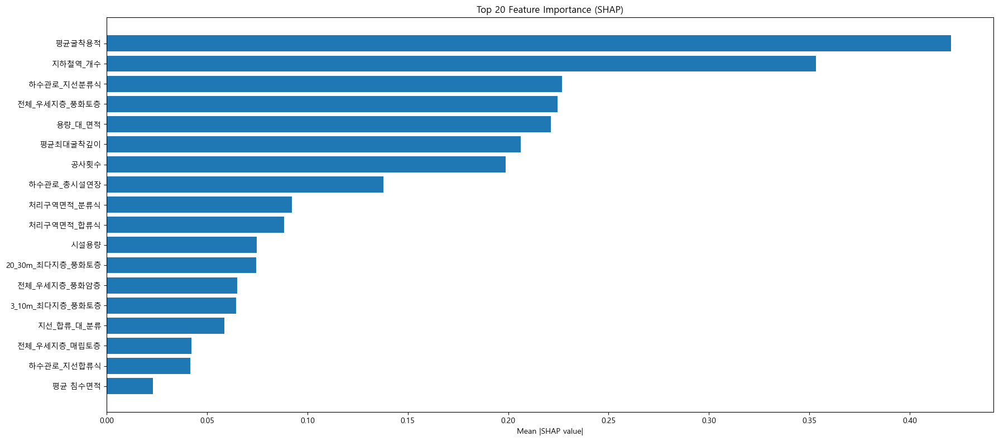

In [36]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

# Load dong_to_shap.csv
dong_df = pd.read_csv("dong_to_shap.csv")

# Group by feature and calculate mean absolute SHAP value
feature_importance_df = dong_df.groupby("영향 인자")["shap_value"].apply(lambda x: np.mean(np.abs(x))).reset_index()
feature_importance_df = feature_importance_df.rename(columns={"shap_value": "mean_abs_shap"})
feature_importance_df = feature_importance_df.sort_values(by="mean_abs_shap", ascending=False)

# Plot top 20 features
top_n = 20
top_features = feature_importance_df.head(top_n)

# Plot
plt.figure(figsize=(18, 8))
plt.barh(top_features["영향 인자"][::-1], top_features["mean_abs_shap"][::-1])
plt.xlabel("Mean |SHAP value|")
plt.title(f"Top {top_n} Feature Importance (SHAP)")
plt.tight_layout()
plt.show()